### Import packages

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
from scipy.spatial import distance
from tqdm import tqdm
import networkx as nx

from itertools import count
import pyproj
#pyproj.datadir.set_data_dir('/usr/local/share/proj')
from pyproj import CRS, Transformer

import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import cartopy.crs as ccrs
import cartopy.io.img_tiles as cimgt

import io
from urllib.request import urlopen, Request
from PIL import Image

### Locate data files on disk

In [2]:
source = '/media/Data_storage/Mobilcell/TimeIntervalGraphs/'
source_pol = '/media/Data_storage/Mobilcell/DayPolygonData/'
destination = '/media/Data_storage/Mobilcell/TimeIntervalGraphs_spektral/'
files = np.array( sorted([ i for i in os.listdir(source) ]) )
files[:10]

array(['graph_20181201_0_minutes-0-60.npz',
       'graph_20181201_10_minutes-600-660.npz',
       'graph_20181201_11_minutes-660-720.npz',
       'graph_20181201_12_minutes-720-780.npz',
       'graph_20181201_13_minutes-780-840.npz',
       'graph_20181201_14_minutes-840-900.npz',
       'graph_20181201_15_minutes-900-960.npz',
       'graph_20181201_16_minutes-960-1020.npz',
       'graph_20181201_17_minutes-1020-1080.npz',
       'graph_20181201_18_minutes-1080-1140.npz'], dtype='<U39')

In [3]:
files.shape

(4800,)

In [4]:
if not os.path.exists( destination ):
    os.makedirs( destination )

#### Dates covered by the files

In [5]:
dates = np.unique( [ j.split('_')[1] for j in files ] )
dates[:4]

array(['20181201', '20181202', '20181203', '20181204'], dtype='<U8')

#### Load a datafile for testing

In [6]:
loaded = np.load(source+files[5])
print( list( loaded.keys() ) )
loaded['data_edge_index'].shape, loaded['data_edge_attr'].shape, loaded['data_x'].shape

['data_edge_index', 'data_edge_attr', 'data_x']


((2, 98426), (98426, 1), (8622, 3))

In [7]:
edge_list = loaded['data_edge_index']
edge_attr = loaded['data_edge_attr']
node_attr = loaded['data_x']
edge_list.shape, edge_attr.shape, node_attr.shape

((2, 98426), (98426, 1), (8622, 3))

#### Load tower location data

In [8]:
tower_info = pd.read_csv( source_pol+'fixed_merged-40_tower_locations.csv' ) ## CHANGED
sort_idx = np.argsort( tower_info.tower_id.values )
tower_info = tower_info.iloc[ sort_idx ]
tower_info.reset_index(inplace=True)

coords = np.unique( tower_info.iloc[:,2:], axis=0 )[:,1:]
coords.shape

(8622, 2)

### Data loader 

In [9]:
def data_loader( source, filename ):
    loaded = np.load( source+filename )
    return loaded['data_edge_index'], loaded['data_edge_attr'], loaded['data_x']

In [10]:
def load_a_day( day_num ):
    daily_files = [ 'graph_'+dates[day_num]+'_'+str(l)+'_minutes-'+\
               str(l*60)+'-'+str((1+l)*60)+'.npz' for l in np.arange(24) ]
    
    # lists to hold loaded data
    edge_indices, edge_weights, features = ( [] for i in range(3) )
    
    for s in range( len(daily_files) ):
        edge_idx, edge_weight, feature = data_loader( source, daily_files[s] )
        edge_indices.append( edge_idx )
        edge_weights.append( edge_weight )
        features.append( feature )
    
    return edge_indices, edge_weights, features

In [11]:
def process_a_day( day_num, snap_counts=3, max_n=24 ):
    # rolling indices
    indexer = np.arange(snap_counts)[None, :] + np.arange(max_n)[:, None]
    indexer_x = indexer[:-snap_counts]
    
    # loaded data for this day
    edge_indices_all, edge_weights_all, features_all = load_a_day(day_num)
    
    # lists to hold loaded data structured for learning
    edge_indices_final = [ [ edge_indices_all[l] for l 
                                        in m ] for m in indexer_x ]
    edge_weights_final = [ [ edge_weights_all[l] for l 
                                        in m ] for m in indexer_x ]
    features_final = [ [ features_all[l][:,-1] for l in m ] for m in indexer_x ]
    
    return edge_indices_final, edge_weights_final, features_final

#### Test data loader functions

In [12]:
edge_indices, edge_weights, features = process_a_day(0, snap_counts=1)

In [13]:
len(edge_weights)

23

In [14]:
edge_indices[0][0].shape, edge_weights[0][0].shape

((2, 24607), (24607, 1))

### Filter data to keep only the important nodes and edges -> based on the first Monday's data:

- node counts: if the node features are under selected value (default 100), then the node will be dropped out, and these selected nodes will be the nodes of the investigated network
- edge counts: if the edge weights are under a selected value, then it will be dropped out, and these selected edges will be the edges of the investigated network

##### node number filter

In [15]:
node_filt = np.sum( np.array( features ), axis=0 ).flatten() / len(features) > 100
node_filt.sum()

3436

##### edge number filter

In [16]:
ef_adj_mat = np.zeros( (coords.shape[0], coords.shape[0], 23), dtype=np.uint32 )

for s in range( len(edge_weights ) ): # go along time steps in a series
    ef_adj_mat[ edge_indices[s][0][0,:], edge_indices[s][0][1,:], s ] = \
                    edge_weights[s][0].flatten()

In [17]:
adj_mat_filter = ( (np.sum( ef_adj_mat[ np.ix_(node_filt, node_filt) ], axis=-1 ) / len(features) ) > 25 )
fix_adj_mat = 1*adj_mat_filter
adj_mat_filter.shape, fix_adj_mat.shape, fix_adj_mat.sum()

((3436, 3436), (3436, 3436), 3150)

#### Node feature dist under 100

Text(0, 0.5, 'Occurences')

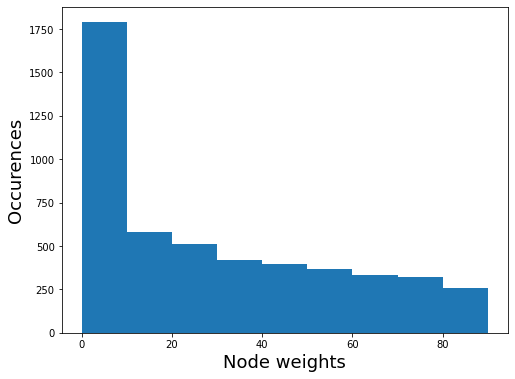

In [18]:
plt.figure( figsize=(8,6))
_ = plt.hist( np.sum( np.array( features ), axis=0 ).flatten() / len(features), bins=np.arange(0, 100, 10) )
plt.xlabel( 'Node weights', fontsize=18 )
plt.ylabel( 'Occurences', fontsize=18)

#### Node feature dist above 100

Text(0, 0.5, 'Occurences')

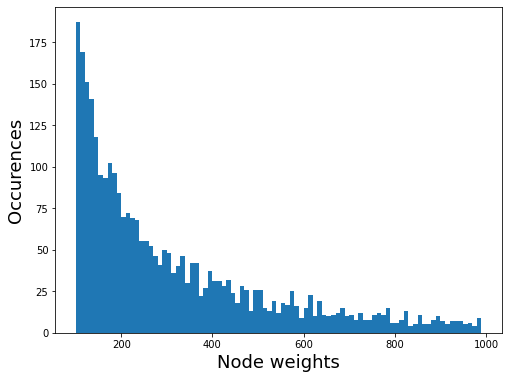

In [19]:
plt.figure( figsize=(8,6))
_ = plt.hist( np.sum( np.array( features ), axis=0 ).flatten() / len(features), bins=np.arange(100, 1000, 10) )
plt.xlabel( 'Node weights', fontsize=18 )
plt.ylabel( 'Occurences', fontsize=18)

Text(0, 0.5, 'Occurences')

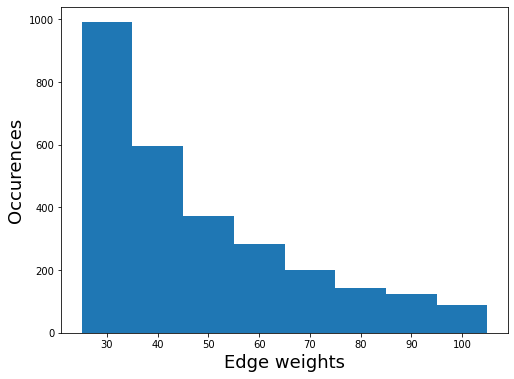

In [20]:
plt.figure( figsize=(8,6))
_ = plt.hist( ( adj_mat_filter * \
            ( np.sum( ef_adj_mat[ np.ix_(node_filt, node_filt) ], axis=-1 ) / len(features) ) ).flatten(), 
         bins=np.arange(25, 110, 10) )
plt.xlabel( 'Edge weights', fontsize=18 )
plt.ylabel( 'Occurences', fontsize=18)

#### Checking code to filter and transform data to networkx graph

##### 2018.12.01. 11:00-12:00

In [21]:
(ef_adj_mat[:,:,10][np.ix_(node_filt, node_filt)] * adj_mat_filter).shape

(3436, 3436)

In [22]:
(ef_adj_mat[:,:,10][np.ix_(node_filt, node_filt)] ).sum()

621481

In [23]:
adj_mat_filter.shape

(3436, 3436)

In [25]:
current_mat = ef_adj_mat[:,:,10][np.ix_(node_filt, node_filt)].astype(np.float32)
current_mat[ np.argwhere( adj_mat_filter )[ ( current_mat[ adj_mat_filter ] < 1 ) ] ] = 1e-5

In [27]:
Q = nx.from_numpy_matrix( current_mat * adj_mat_filter,
                          create_using=nx.Graph) #create_using=nx.MultiDiGraph)
len( Q.nodes() ), len( Q.edges() )

(3436, 3150)

In [28]:
nx.set_node_attributes(Q, 
                       values=dict(zip( np.arange(features[10][0][node_filt].shape[0]), features[10][0][node_filt] ) ), 
                       name='node_weight')
node_attrs = features[10][0][node_filt]

### Graph visualization

In [29]:
def image_spoof(self, tile):
    '''this function reformats web requests from OSM for cartopy
    Heavily based on code by Joshua Hrisko at:
        https://makersportal.com/blog/2020/4/24/geographic-visualizations-in-python-with-cartopy'''

    url = self._image_url(tile)                # get the url of the street map API
    req = Request(url)                         # start request
    req.add_header('User-agent','Anaconda 3')  # add user agent to request
    fh = urlopen(req) 
    im_data = io.BytesIO(fh.read())            # get image
    fh.close()                                 # close url
    img = Image.open(im_data)                  # open image with PIL
    img = img.convert(self.desired_tile_form)  # set image format
    return img, self.tileextent(tile), 'lower' # reformat for cartopy

In [30]:
crs_eov = CRS.from_epsg("23700")
crs_lonlat = CRS.from_epsg("4326")
#crs_eov, crs_lonlat
transformer = Transformer.from_crs(crs_eov, crs_lonlat)
x_, y_ = transformer.transform( xx=coords[:,1][node_filt],
                                yy=coords[:,0][node_filt]  )

## https://stackoverflow.com/questions/28910766/python-networkx-set-node-color-automatically-based-on-number-of-attribute-opt
groups = set(nx.get_node_attributes(Q,'node_weight').values())
mapping = dict(zip(sorted(groups),count()))
nodes = Q.nodes()
colors = [ mapping[Q.nodes[n]['node_weight']] for n in nodes]

Text(0, 0.5, 'Attribute values')

/usr/local/lib/python3.6/dist-packages/Cartopy-0.17.0-py3.6-linux-x86_64.egg/cartopy/mpl/geoaxes.py:388: MatplotlibDeprecationWarning: 
The 'inframe' parameter of draw() was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use Axes.redraw_in_frame() instead. If any parameter follows 'inframe', they should be passed as keyword, not positionally.
  inframe=inframe)


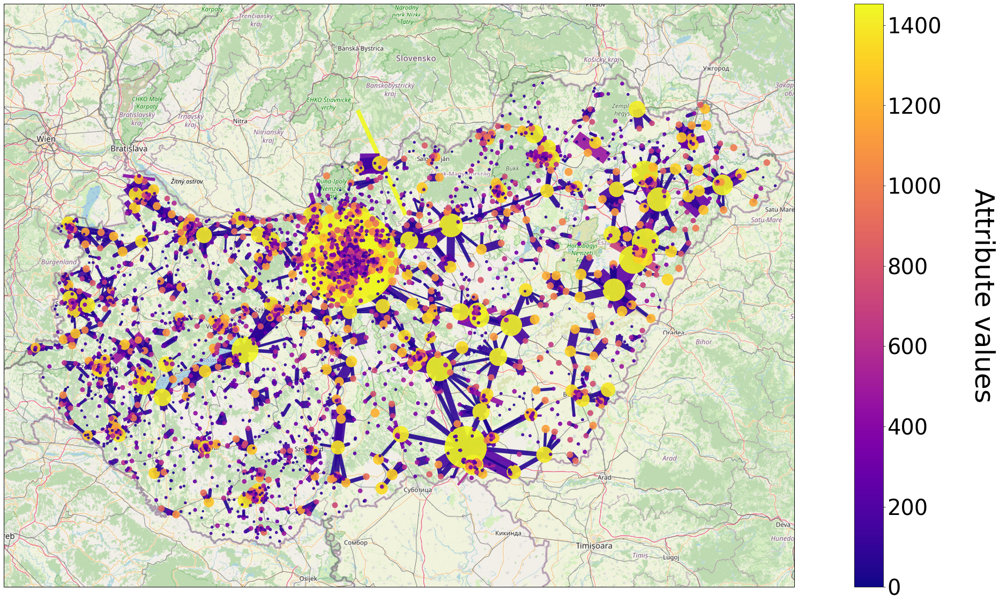

In [31]:
# Plot graph on map
cimgt.OSM.get_image = image_spoof 
request = cimgt.OSM() # openstreetmap or google map background

# figure settings
fig, ax = plt.subplots( figsize=(40,20), subplot_kw=dict(projection=request.crs))
extent = [16, 23, 45.5, 49]  # (xmin, xmax, ymin, ymax) # select ROI
ax.set_extent(extent)

ax.add_image(request, 8, interpolation='spline36')

graph_lon = y_
graph_lat = x_

pos_lonlat_nx = { j : ( graph_lon[i], 
                     graph_lat[i] ) for i, j in enumerate(list(Q.nodes)) }

# do coordinate conversion of (x,y), Geodetic is the default in set_extent()
pos_geo = ax.projection.transform_points( ccrs.Geodetic(), 
                                        graph_lon, graph_lat)

pos_geo_nx = { j : ( pos_geo[i,0], 
                     pos_geo[i,1] ) for i, j in enumerate(list(Q.nodes)) }

edges, weights = zip(*nx.get_edge_attributes(Q,'weight').items())

nx.draw(Q, pos=pos_geo_nx, node_color=colors, node_size=np.divide(node_attrs, 10),
        edgelist=edges, edge_color=weights, width=np.divide( weights, 10), 
        edge_cmap=plt.cm.plasma, alpha=0.9, cmap=plt.cm.plasma )

cmap = plt.cm.plasma
# create normalization instance
norm = plt.cm.colors.Normalize(vmin=0, vmax=max(colors)) 
# create a scalarmappable from the colormap
sm_nodes = plt.cm.ScalarMappable(cmap=cmap, norm=norm)    
sm_nodes.set_array([]) 
cbar = plt.colorbar(sm_nodes)
cbar.ax.tick_params(labelsize=40)
cbar.ax.set_ylabel('Attribute values', labelpad=100, fontsize=50, rotation=270) 


Text(0, 0.5, 'Attribute values')

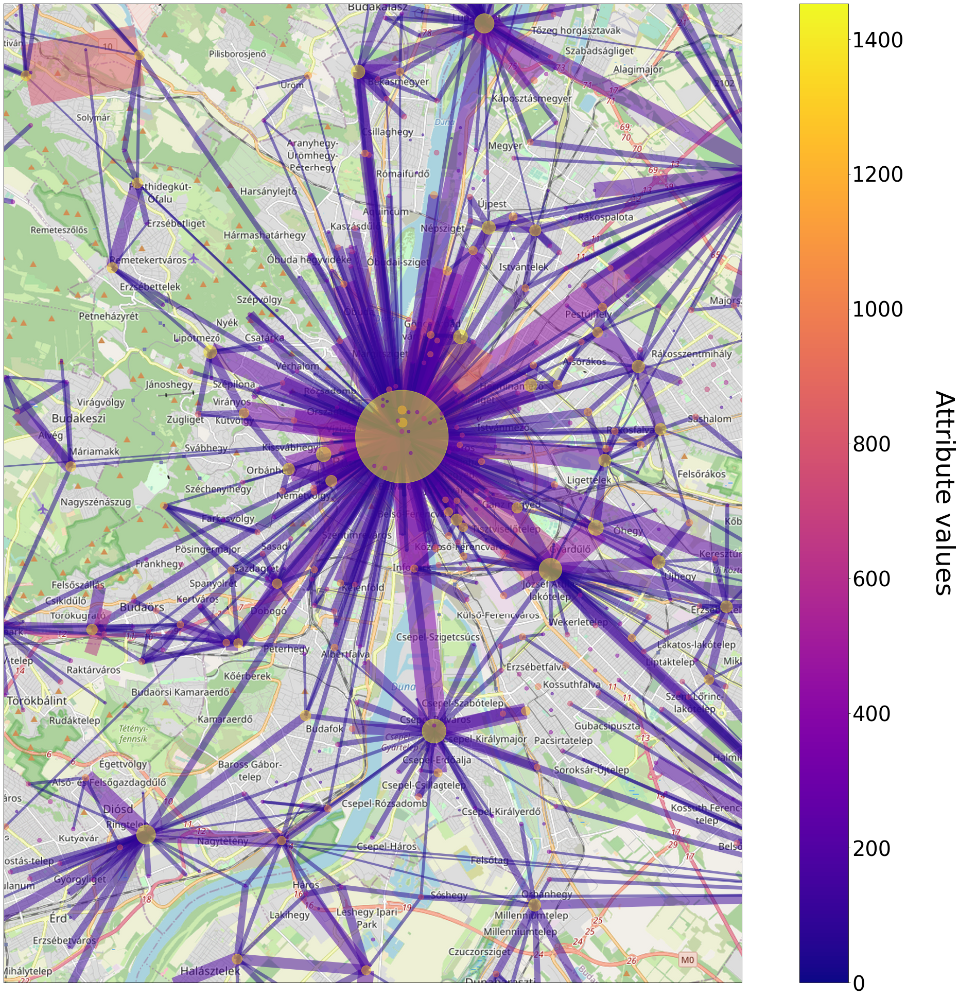

In [32]:
# Plot graph on map
request = cimgt.OSM() # openstreetmap or google map background

# figure settings
fig, ax = plt.subplots(figsize=(40,35), subplot_kw=dict(projection=request.crs))
extent = [18.9, 19.19, 47.36, 47.62]  # (xmin, xmax, ymin, ymax) # select ROI
ax.set_extent(extent)
ax.add_image(request, 12, interpolation='spline36') # 7 is a layer num, higher means more detail

graph_lon = y_
graph_lat = x_

pos_lonlat_nx = { j : ( graph_lon[i], 
                     graph_lat[i] ) for i, j in enumerate(list(Q.nodes)) }

# do coordinate conversion of (x,y), Geodetic is the default in set_extent()
pos_geo = ax.projection.transform_points( ccrs.Geodetic(), 
                                        graph_lon, graph_lat)

pos_geo_nx = { j : ( pos_geo[i,0], 
                     pos_geo[i,1] ) for i, j in enumerate(list(Q.nodes)) }

edges, weights = zip(*nx.get_edge_attributes(Q,'weight').items())

nx.draw(Q, pos=pos_geo_nx, node_color=colors, node_size=np.divide(node_attrs,10),
        edgelist=edges, edge_color=weights, width=np.divide(weights, 10), 
        edge_cmap=plt.cm.plasma, alpha=0.5, cmap=plt.cm.plasma )

cmap = plt.cm.plasma
# create normalization instance
norm = plt.cm.colors.Normalize(vmin=0, vmax=max(colors)) 
# create a scalarmappable from the colormap
sm_nodes = plt.cm.ScalarMappable(cmap=cmap, norm=norm)    
sm_nodes.set_array([]) 
cbar = plt.colorbar(sm_nodes)
cbar.ax.tick_params(labelsize=40)
cbar.ax.set_ylabel('Attribute values', labelpad=100, fontsize=50, rotation=270) 

### Line graph creation 

In [33]:
fix_adj_mat.shape, (current_mat * adj_mat_filter).shape, np.argwhere( (current_mat * adj_mat_filter) ).shape

((3436, 3436), (3436, 3436), (3150, 2))

##### how to retrieve edge attributes for the line graph's node attributes

In [34]:
edges, weights = zip(*nx.get_edge_attributes(Q,'weight').items())
edges_to_weights = dict( zip(edges, weights) )
edges_to_weights[(0, 2)]

213.0

In [35]:
L = nx.line_graph(Q)

In [36]:
L_adj_mat = nx.to_numpy_matrix(L).astype(np.uint32)
L_adj_mat.shape

(3150, 3150)

In [37]:
adj_mat_filter.sum()

3150

In [38]:
L_nfs = [ edges_to_weights[i] for i in list(L.nodes()) ]

In [52]:
edges_to_weights_line = dict( zip(list(L.nodes()), L_nfs) )

In [53]:
len( list( L.nodes() )), len(edges)

(3150, 3150)

In [66]:
np.savez_compressed( destination+'../'+'graph_conversion_info', 
                     nodes_line_graph=[ str(m) for m in list(L.nodes()) ], 
                     edges_original_graph=[ str(n) for n in list(Q.edges()) ] )

#### some older codes currently not in use

#### final data prep function

In [39]:
def create_samples_from_a_day_line_graph( daynum=0, snap_counts=4 ):
    '''Dataset preparation for edge attribute prediction with line graph'''
    edge_indices, edge_weights, features = process_a_day(daynum, snap_counts=snap_counts)
    
    nf_all = np.zeros( (len(edge_indices), node_filt.sum(), snap_counts), dtype=np.uint32 )
    ef_mat_all = np.zeros( (len(edge_indices), node_filt.sum(), node_filt.sum(), snap_counts), dtype=np.uint32 )
    nf_line_all = np.zeros( (len(edge_indices), adj_mat_filter.sum(), snap_counts+22+7), dtype=np.float32 )
    
    # generation of data structures for "normal" graph
    for s in range( len(edge_indices) ): # go along samples
        nf = np.zeros( (coords.shape[0], snap_counts), dtype=np.uint32 )
        ef_mat = np.zeros( (coords.shape[0], coords.shape[0], snap_counts), dtype=np.uint32 )
        
        for t in range( len(edge_indices[s] ) ): # go along time steps in a series
            ef_mat[ edge_indices[s][t][0,:], edge_indices[s][t][1,:], t ] = edge_weights[s][t].flatten()
            nf[:,t] = features[s][t]
        
        nf_all[s] = np.copy( nf[ node_filt ] )
        ef_mat_all[s] = np.copy( ef_mat[ np.ix_(node_filt, node_filt) ] )
    
    # generation of data structures for line graph
    for s in range( len(edge_indices) ): # go along samples
        for t in range( len(edge_indices[s] ) ): # go along time steps in a series
            current_mat = ef_mat_all[s, :, :, t].astype(np.float32)
            current_mat[ np.argwhere( adj_mat_filter )[ ( current_mat[ adj_mat_filter ] < 1 ) ] ] = 1e-5
            
            # get "normal" matrix as networkx graph
            S = nx.from_numpy_matrix( current_mat * adj_mat_filter,
                                      create_using=nx.Graph )
            
            # transform graph to line graph
            L = nx.line_graph(S)
            L_adj_mat = nx.to_numpy_matrix(L) # get adj mat of line_graph
            edges, weights = zip(*nx.get_edge_attributes(S,'weight').items())
            edges_to_weights = dict( zip(edges, weights) )
            L_nfs = [ edges_to_weights[i] for i in list(L.nodes()) ]
            
            nf_line_all[s, :, t] = L_nfs  # saving node features
            if t < (len(edge_indices[s])-1): # not saving targets time point
                nf_line_all[s,:,snap_counts+s+t] = np.repeat( [1], nf_line_all.shape[1] )
            nf_line_all[s,:,snap_counts+22+(daynum%7)] = np.repeat( [1], nf_line_all.shape[1] )            
 
    np.savez_compressed( destination+'graphNN_linegraph_samples_series-'+str(snap_counts-1)+'_target-1_'+dates[daynum],
                         node_filt=node_filt,
                         adj_mat_filt=adj_mat_filter,
                         adj_mat_line=L_adj_mat,
                         nf=nf_all,
                         ef_mat=ef_mat_all,
                         nf_line=nf_line_all )

#### Code to include only weekdays

In [40]:
max_num_days = 200
weekdays = np.sort( np.concatenate( ( np.arange( max_num_days )[2::7].reshape(-1,1), 
                  np.arange( max_num_days )[3::7].reshape(-1,1), 
                  np.arange( max_num_days )[4::7].reshape(-1,1),
                  np.arange( max_num_days )[5::7].reshape(-1,1),
                  np.arange( max_num_days )[6::7].reshape(-1,1) ) ).flatten() )

#### Only weekdays

#### Including weekends

In [107]:
# processing all weekdays:
for w in tqdm( range( 0, 200 ) ):
    create_samples_from_a_day_line_graph(w, snap_counts=4)


100%|██████████| 30/30 [25:40<00:00, 51.34s/it]


### Test if everything works correctly

##### first day encodings

In [108]:
loaded = np.load( destination+'graphNN_linegraph_samples_series-'+str(4-1)+'_target-1_'+dates[0]+'.npz' )
print( loaded['nf_line'][0,0] )
print( loaded['nf_line'][1,0] )
print( loaded['nf_line'][-1,0] )

[6. 5. 6. 7. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 0.]
[5. 6. 7. 8. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 1. 0. 0. 0. 0. 0. 0.]
[24. 18. 15. 13.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  1.  1.  1.  1.  0.  0.  0.  0.  0.  0.]


##### second day encodings

In [109]:
loaded = np.load( destination+'graphNN_linegraph_samples_series-'+str(4-1)+'_target-1_'+dates[1]+'.npz' )
print( loaded['nf_line'][0,0] )
print( loaded['nf_line'][1,0] )
print( loaded['nf_line'][-1,0] )

[6. 2. 3. 4. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 0.]
[2. 3. 4. 3. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 1. 0. 0. 0. 0. 0.]
[11. 10.  7.  3.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  1.  1.  1.  0.  1.  0.  0.  0.  0.  0.]


##### seventh day encodings

In [110]:
loaded = np.load( destination+'graphNN_linegraph_samples_series-'+str(4-1)+'_target-1_'+dates[6]+'.npz' )
print( loaded['nf_line'][0,0] )
print( loaded['nf_line'][1,0] )
print( loaded['nf_line'][-1,0] )

[2. 5. 3. 2. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[5. 3. 2. 8. 0. 1. 1. 1. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 1.]
[32. 24. 17. 14.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.  0.
  0.  0.  0.  0.  0.  1.  1.  1.  0.  0.  0.  0.  0.  0.  1.]


### Visualization of prediction

#### 2018.12.01, 11:00-12:00

In [79]:
Q_pred_edges = np.load( '/media/Data_storage/Mobilcell/GraphNN_linegraph_edge_prediction_test.npy' )

#### Mean absolute error in edge weights

In [89]:
np.mean( np.abs( Q_pred_edges*1000-weights ) )

38.34290680646034

#### Plotting on map

Text(0, 0.5, 'Attribute values')

/usr/local/lib/python3.6/dist-packages/Cartopy-0.17.0-py3.6-linux-x86_64.egg/cartopy/mpl/geoaxes.py:388: MatplotlibDeprecationWarning: 
The 'inframe' parameter of draw() was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use Axes.redraw_in_frame() instead. If any parameter follows 'inframe', they should be passed as keyword, not positionally.
  inframe=inframe)


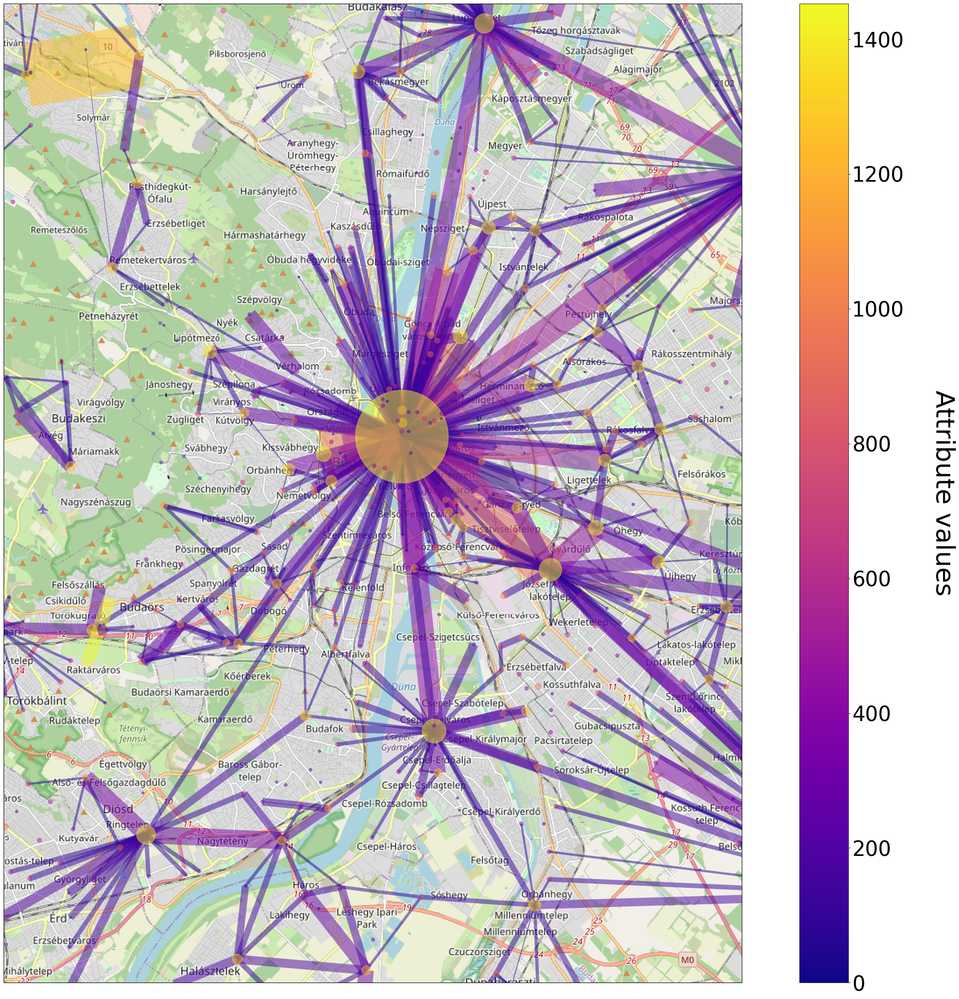

In [76]:
# Plot graph on map
request = cimgt.OSM() # openstreetmap or google map background

# figure settings
fig, ax = plt.subplots(figsize=(40,35), subplot_kw=dict(projection=request.crs))
extent = [18.9, 19.19, 47.36, 47.62]  # (xmin, xmax, ymin, ymax) # select ROI
ax.set_extent(extent)
ax.add_image(request, 12, interpolation='spline36') # 7 is a layer num, higher means more detail

graph_lon = y_
graph_lat = x_

pos_lonlat_nx = { j : ( graph_lon[i], 
                     graph_lat[i] ) for i, j in enumerate(list(Q.nodes)) }

# do coordinate conversion of (x,y), Geodetic is the default in set_extent()
pos_geo = ax.projection.transform_points( ccrs.Geodetic(), 
                                        graph_lon, graph_lat)

pos_geo_nx = { j : ( pos_geo[i,0], 
                     pos_geo[i,1] ) for i, j in enumerate(list(Q.nodes)) }

nx.draw(Q, pos=pos_geo_nx, node_color=colors, node_size=np.divide(node_attrs,10),
        edgelist=edges, edge_color=np.multiply(Q_pred_edges, 100), 
        width=np.multiply(Q_pred_edges, 100), 
        edge_cmap=plt.cm.plasma, alpha=0.5, cmap=plt.cm.plasma )

cmap = plt.cm.plasma
# create normalization instance
norm = plt.cm.colors.Normalize(vmin=0, vmax=max(colors)) 
# create a scalarmappable from the colormap
sm_nodes = plt.cm.ScalarMappable(cmap=cmap, norm=norm)    
sm_nodes.set_array([]) 
cbar = plt.colorbar(sm_nodes)
cbar.ax.tick_params(labelsize=40)
cbar.ax.set_ylabel('Attribute values', labelpad=100, fontsize=50, rotation=270) 

Text(0, 0.5, 'Attribute values')

/usr/local/lib/python3.6/dist-packages/Cartopy-0.17.0-py3.6-linux-x86_64.egg/cartopy/mpl/geoaxes.py:388: MatplotlibDeprecationWarning: 
The 'inframe' parameter of draw() was deprecated in Matplotlib 3.3 and will be removed two minor releases later. Use Axes.redraw_in_frame() instead. If any parameter follows 'inframe', they should be passed as keyword, not positionally.
  inframe=inframe)


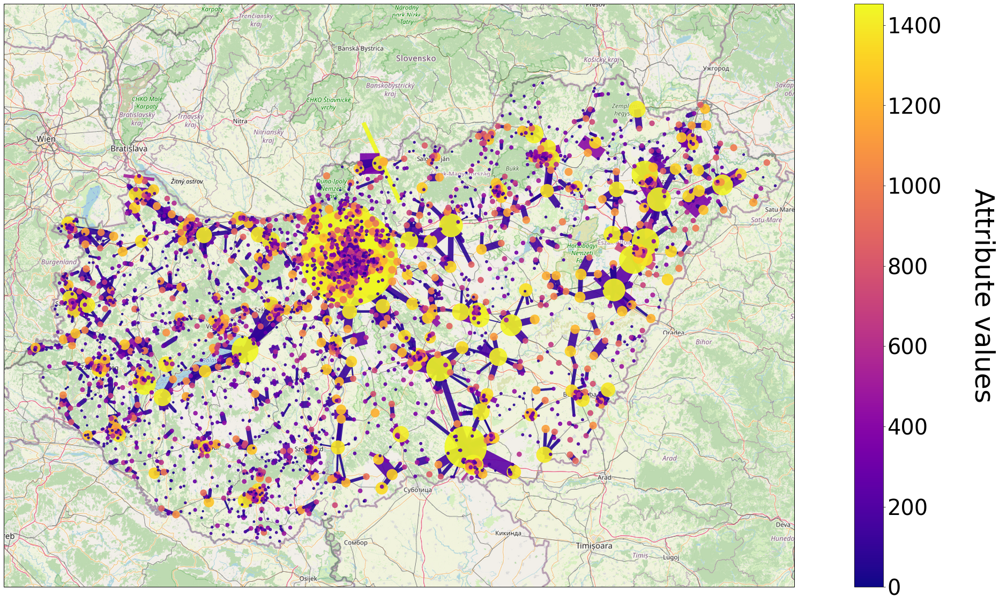

In [90]:
# Plot graph on map
cimgt.OSM.get_image = image_spoof 
request = cimgt.OSM() # openstreetmap or google map background

# figure settings
fig, ax = plt.subplots( figsize=(40,20), subplot_kw=dict(projection=request.crs))
extent = [16, 23, 45.5, 49]  # (xmin, xmax, ymin, ymax) # select ROI
ax.set_extent(extent)

ax.add_image(request, 8, interpolation='spline36')

graph_lon = y_
graph_lat = x_

pos_lonlat_nx = { j : ( graph_lon[i], 
                     graph_lat[i] ) for i, j in enumerate(list(Q.nodes)) }

# do coordinate conversion of (x,y), Geodetic is the default in set_extent()
pos_geo = ax.projection.transform_points( ccrs.Geodetic(), 
                                        graph_lon, graph_lat)

pos_geo_nx = { j : ( pos_geo[i,0], 
                     pos_geo[i,1] ) for i, j in enumerate(list(Q.nodes)) }

nx.draw(Q, pos=pos_geo_nx, node_color=colors, node_size=np.divide(node_attrs, 10),
        edgelist=edges, edge_color=np.multiply(Q_pred_edges, 100),
        width=np.multiply( Q_pred_edges, 100), 
        edge_cmap=plt.cm.plasma, alpha=0.9, cmap=plt.cm.plasma )

cmap = plt.cm.plasma
# create normalization instance
norm = plt.cm.colors.Normalize(vmin=0, vmax=max(colors)) 
# create a scalarmappable from the colormap
sm_nodes = plt.cm.ScalarMappable(cmap=cmap, norm=norm)    
sm_nodes.set_array([]) 
cbar = plt.colorbar(sm_nodes)
cbar.ax.tick_params(labelsize=40)
cbar.ax.set_ylabel('Attribute values', labelpad=100, fontsize=50, rotation=270) 